# 馬達定位點偵測

Copyright © 2019 Hsu Shih-Chieh  

算法筆記: https://hackmd.io/@JHSU/r1-gN6OlH

In [2]:
%load_ext autoreload
%autoreload 2
import numpy as np
import keras.backend as K
from keras.layers import Input, Lambda
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import TensorBoard, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from utils import preprocess_true_boxes, yolo_body, tiny_yolo_body, yolo_loss, get_random_data
from timeit import default_timer as timer
#from keras.utils import multi_gpu_model
import os  
import matplotlib.pyplot as plt
from datasets import load_motoranchordata
from utils import YOLOV3

os.environ['CUDA_VISIBLE_DEVICES']='0' 

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


W1023 08:39:27.077741 140247622207232 lazy_loader.py:50] 
The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



Segmentation Models: using `keras` framework.


In [3]:
def create_model(input_shape, anchors, num_classes, load_pretrained=True, freeze_body=2, weights_path='model_data/yolo_weights.h5'):
    '''create the training model'''
    K.clear_session() # get a new session
    image_input = Input(shape=(None, None, 3))
    h, w = input_shape
    num_anchors = len(anchors)

    y_true = [Input(shape=(h//{0:32, 1:16, 2:8}[l], w//{0:32, 1:16, 2:8}[l], \
        num_anchors//3, num_classes+5)) for l in range(3)]

    model_body = yolo_body(image_input, num_anchors//3, num_classes)
    print('Create YOLOv3 model with {} anchors and {} classes.'.format(num_anchors, num_classes))

    if load_pretrained:
        model_body.load_weights(weights_path, by_name=True, skip_mismatch=True)
        print('Load weights {}.'.format(weights_path))
        if freeze_body in [1, 2]:
            num = (185, len(model_body.layers)-3)[freeze_body-1]
            for i in range(num): model_body.layers[i].trainable = False
            print('Freeze the first {} layers of total {} layers.'.format(num, len(model_body.layers)))

    model_loss = Lambda(yolo_loss, output_shape=(1,), name='yolo_loss',
        arguments={'anchors': anchors, 'num_classes': num_classes, 'ignore_thresh': 0.5})(
        [*model_body.output, *y_true])
    model = Model([model_body.input, *y_true], model_loss)

    return model


### Load Data

In [4]:

metadata = load_motoranchordata(get_random_data, preprocess_true_boxes)
print(metadata.DESCR)

Motor Anchor dataset
---------------------------

**Data Set Characteristics:**

    :照片數量: 641
    
    :類別數量: 1
    
    :source code: datasets/base.py
    
    :method: load_hotmeltyolodata()    


**讀取數據Sample Code**

::

    from datasets import load_hotmeltyolodata
    data = load_hotmeltyolodata()
    lines = data.data

**Model Characteristics**

    :Object Detection Model: YOLOv3 (keras ver.)
    
    :input size: (416,416,3)
    
    :output: boxes, in [(upper, left, lower, right),] format
    
    :pretrain: imagenet pretrain model, keras builtin weight
    
    :anchors: Default
    
    :output model format: h5
    
    :source code: img_hotmelt_ROI.ipynb
    
    :需要自己實作的部分: yolov3

**Training Hyperparameter**  

    :lose: {'yolo_loss': lambda y_true, y_pred: y_pred}
    
    :optimizer: adam
    
    :batch size: 7
    
    :EarlyStopping: patience=10
    
    :ReduceLROnPlateau: factor=0.5, patience=10
    
    :epoch: 25+50

**Inference Sample Code**

::
    from util

In [5]:

anchors_str= '10,13,  16,30,  33,23,  30,61,  62,45,  59,119,  116,90,  156,198,  373,326'
anchors = np.array([float(x) for x in anchors_str.split(',')]).reshape(-1, 2)
input_shape = (416,416) 
num_classes = metadata.num_classes
model = create_model(input_shape, anchors, num_classes, freeze_body=2, weights_path='model/yolov3_weights.h5') # make sure you know what you freeze

#logging = TensorBoard(log_dir=log_dir)
#checkpoint = ModelCheckpoint(log_dir + 'ep{epoch:03d}-loss{loss:.3f}-val_loss{val_loss:.3f}.h5', monitor='val_loss', save_weights_only=True, save_best_only=True, period=3)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=1)


#model = multi_gpu_model(model, gpus=2)
model.compile(optimizer=Adam(lr=1e-3), loss={
    'yolo_loss': lambda y_true, y_pred: y_pred})

batch_size = 7
print('Train on {} samples, val on {} samples, with batch size {}.'.format(metadata.num_train, metadata.num_val, metadata.batch_size))
model.fit_generator(metadata.generator_tr, validation_data=metadata.generator_val,
        steps_per_epoch=max(1, metadata.num_train//metadata.batch_size), validation_steps=max(1, metadata.num_val//metadata.batch_size),
        epochs=50, initial_epoch=0, callbacks=[reduce_lr, early_stopping])

#model.save_weights('model/hotmelt_yolov3weight_tmp.h5')

for i in range(len(model.layers)):
    model.layers[i].trainable = True
    
model.compile(optimizer=Adam(lr=1e-4), loss={'yolo_loss': lambda y_true, y_pred: y_pred}) # recompile to apply the change
print('Train on {} samples, val on {} samples, with batch size {}.'.format(metadata.num_train, metadata.num_val, metadata.batch_size))
history = model.fit_generator(metadata.generator_tr, validation_data=metadata.generator_val,
        steps_per_epoch=max(1, metadata.num_train//metadata.batch_size), validation_steps=max(1, metadata.num_val//metadata.batch_size),
        epochs=150, initial_epoch=50, callbacks=[reduce_lr, early_stopping])

model.save_weights('model/motoranchor_yolov3weight.h5')



W1023 08:39:29.240655 140247622207232 deprecation_wrapper.py:119] From /home/bigdata/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:95: The name tf.reset_default_graph is deprecated. Please use tf.compat.v1.reset_default_graph instead.

W1023 08:39:29.241020 140247622207232 deprecation_wrapper.py:119] From /home/bigdata/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:98: The name tf.placeholder_with_default is deprecated. Please use tf.compat.v1.placeholder_with_default instead.

W1023 08:39:29.242638 140247622207232 deprecation_wrapper.py:119] From /home/bigdata/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:102: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W1023 08:39:29.242961 140247622207232 deprecation_wrapper.py:119] From /home/bigdata/.local/lib/python3.6/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use

Create YOLOv3 model with 9 anchors and 1 classes.


/home/bigdata/.local/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_59 due to mismatch in shape ((1, 1, 1024, 18) vs (255, 1024, 1, 1)).
  weight_values[i].shape))
/home/bigdata/.local/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_59 due to mismatch in shape ((18,) vs (255,)).
  weight_values[i].shape))
/home/bigdata/.local/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_67 due to mismatch in shape ((1, 1, 512, 18) vs (255, 512, 1, 1)).
  weight_values[i].shape))
/home/bigdata/.local/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_67 due to mismatch in shape ((18,) vs (255,)).
  weight_values[i].shape))
/home/bigdata/.local/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights

Load weights model/yolov3_weights.h5.
Freeze the first 249 layers of total 252 layers.


W1023 08:39:37.155865 140247622207232 deprecation_wrapper.py:119] From /home/bigdata/.local/lib/python3.6/site-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



Train on 144 samples, val on 16 samples, with batch size 10.
Epoch 1/50
14/14 [==============================] - 13s 911ms/step - loss: 4822.4574 - val_loss: 1661.7522
Epoch 2/50
14/14 [==============================] - 11s 778ms/step - loss: 1013.1286 - val_loss: 478.2943
Epoch 3/50
14/14 [==============================] - 12s 833ms/step - loss: 386.6110 - val_loss: 229.8796
Epoch 4/50
14/14 [==============================] - 12s 823ms/step - loss: 228.2568 - val_loss: 160.2313
Epoch 5/50
14/14 [==============================] - 12s 828ms/step - loss: 175.0473 - val_loss: 122.2388
Epoch 6/50
14/14 [==============================] - 12s 833ms/step - loss: 146.9678 - val_loss: 108.8733
Epoch 7/50
14/14 [==============================] - 12s 827ms/step - loss: 125.8407 - val_loss: 110.1503
Epoch 8/50
14/14 [==============================] - 12s 827ms/step - loss: 107.7948 - val_loss: 80.4561
Epoch 9/50
14/14 [==============================] - 12s 821ms/step - loss: 94.8383 - val_loss: 74

Epoch 73/150
14/14 [==============================] - 12s 825ms/step - loss: 13.2905 - val_loss: 12.5696
Epoch 74/150
14/14 [==============================] - 12s 824ms/step - loss: 13.2328 - val_loss: 13.2057

Epoch 00074: ReduceLROnPlateau reducing learning rate to 9.999999974752428e-08.
Epoch 75/150
14/14 [==============================] - 12s 828ms/step - loss: 13.1551 - val_loss: 12.3771
Epoch 76/150
14/14 [==============================] - 12s 826ms/step - loss: 12.8639 - val_loss: 12.4473
Epoch 77/150
14/14 [==============================] - 12s 821ms/step - loss: 13.0258 - val_loss: 13.1424

Epoch 00077: ReduceLROnPlateau reducing learning rate to 1.0000000116860975e-08.
Epoch 78/150
14/14 [==============================] - 12s 826ms/step - loss: 13.1312 - val_loss: 12.5977
Epoch 00078: early stopping


### Testing

In [6]:
from PIL import Image, ImageFont, ImageDraw
def drawimg(img, box):
    print(box)
    draw = ImageDraw.Draw(img)
    top, left, bottom, right = box
    top = max(0, np.floor(top + 0.5).astype('int32'))
    left = max(0, np.floor(left + 0.5).astype('int32'))
    bottom = min(image.size[1], np.floor(bottom + 0.5).astype('int32'))
    right = min(image.size[0], np.floor(right + 0.5).astype('int32'))
    print((left, top), (right, bottom))
    for i in range(3):
        draw.rectangle([left - i, top - i, right + i, bottom + i], outline=255, fill=None)
    return img

In [7]:
yolo=YOLOV3(model_path='model/motoranchor_yolov3weight.h5')

model/motoranchor_yolov3weight.h5 model, anchors, and classes loaded.


[1742.1833 1655.0518 1768.502  1695.9175]
(1655, 1742) (1696, 1769)


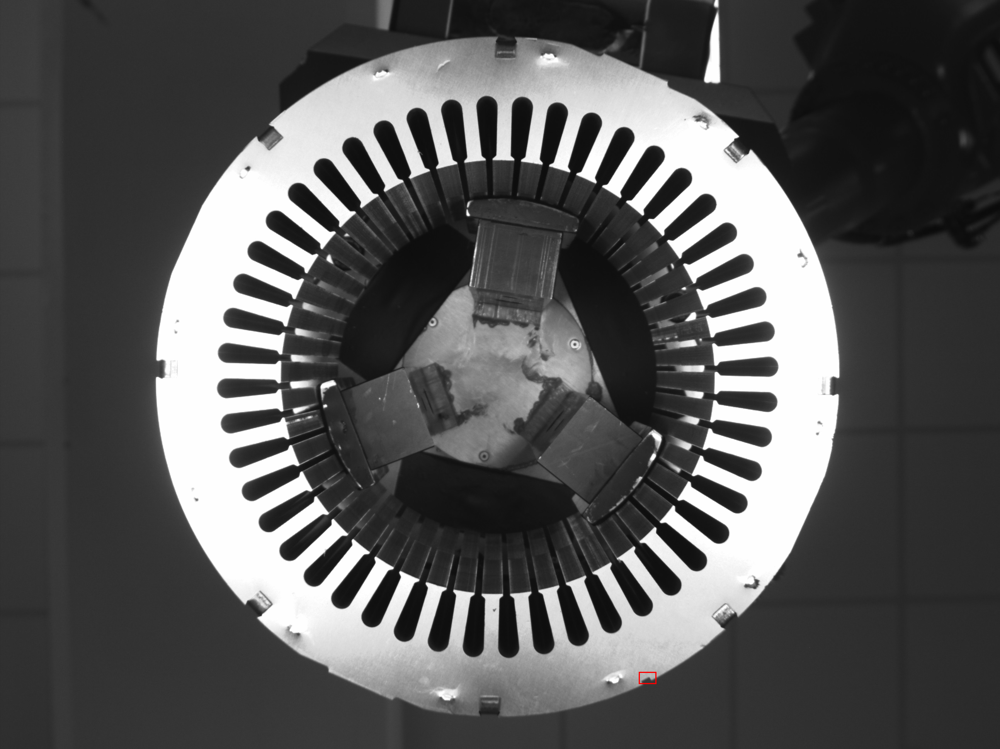

[1393.2764 1889.0438 1425.1085 1925.9683]
(1889, 1393) (1926, 1425)


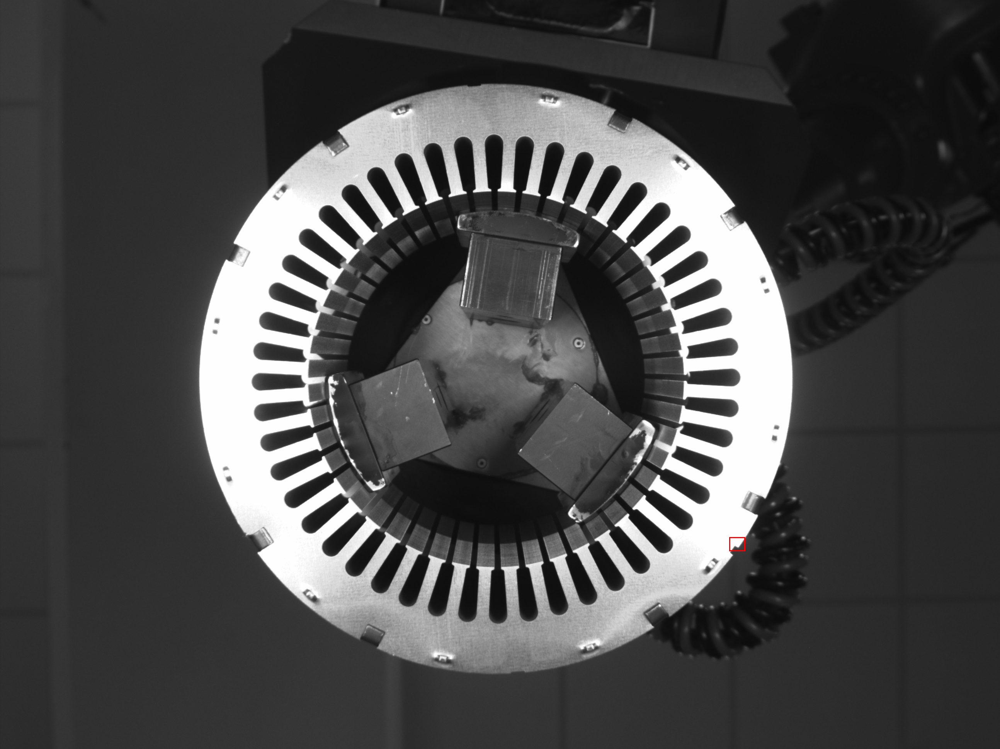

[  74.62867  1326.3317     98.284164 1369.5557  ]
(1326, 75) (1370, 98)


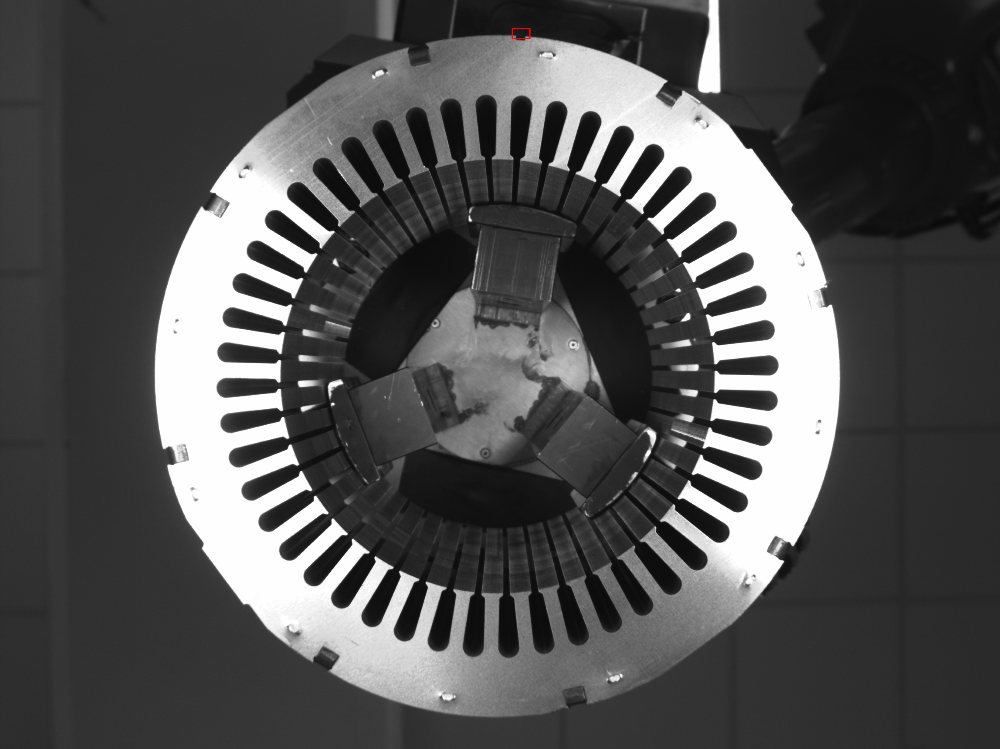

[  76.52805  1340.1757    101.019264 1370.1682  ]
(1340, 77) (1370, 101)


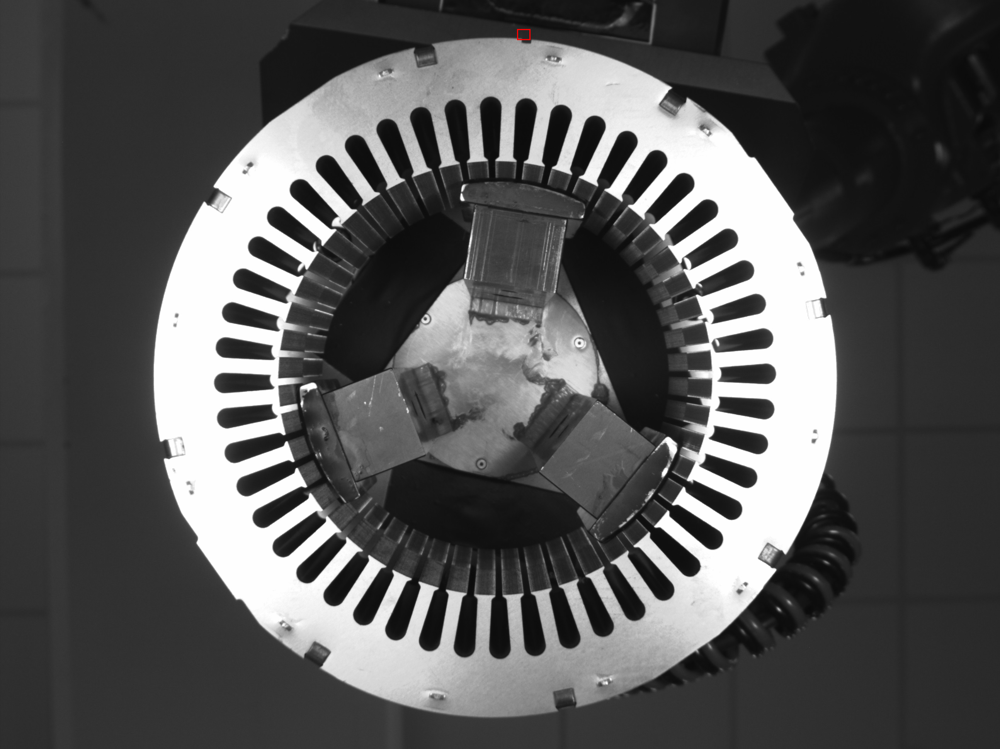

[760.7217  529.42303 799.39557 558.70886]
(529, 761) (559, 799)


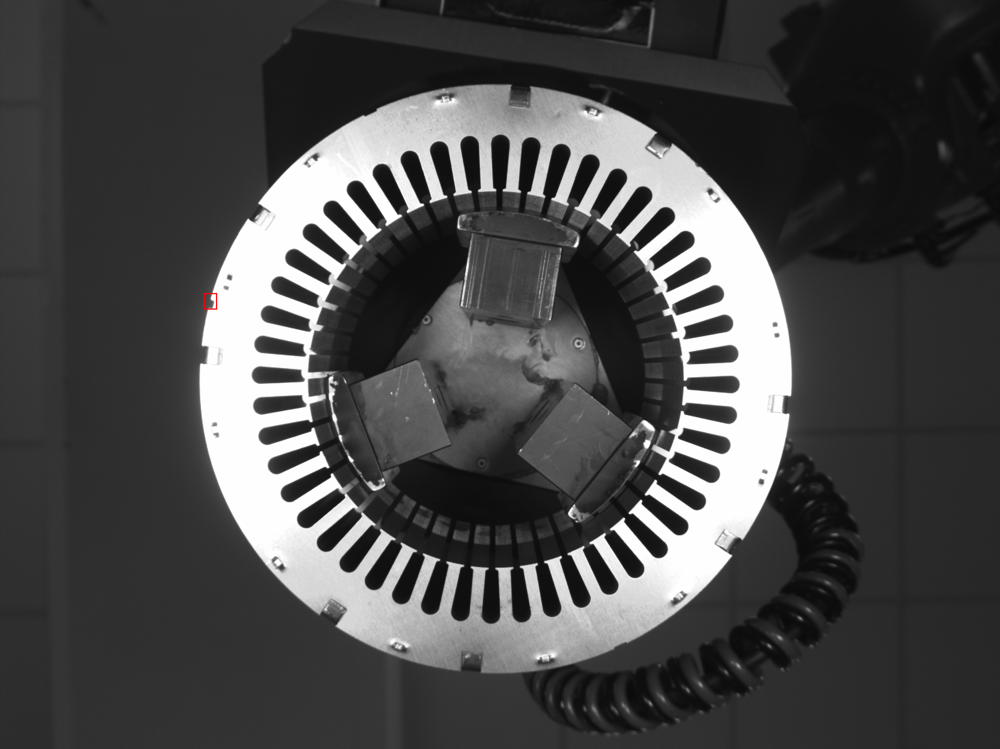

[1414.247    518.9527  1445.2517   548.66425]
(519, 1414) (549, 1445)


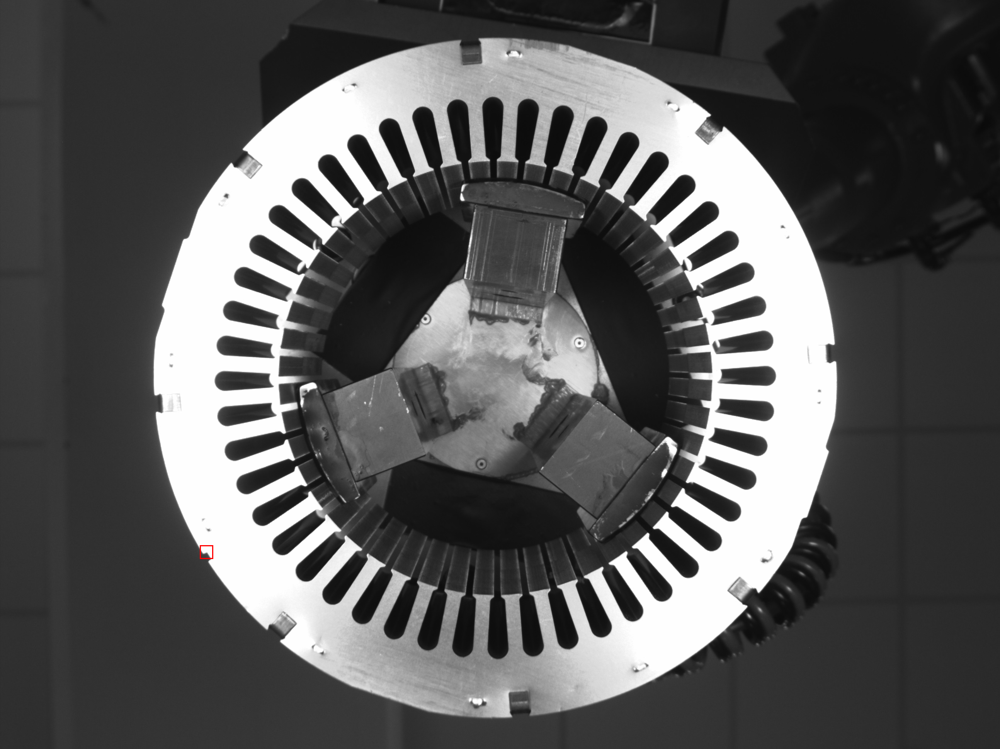

[890.4444  506.53857 924.15247 526.5893 ]
(507, 890) (527, 924)


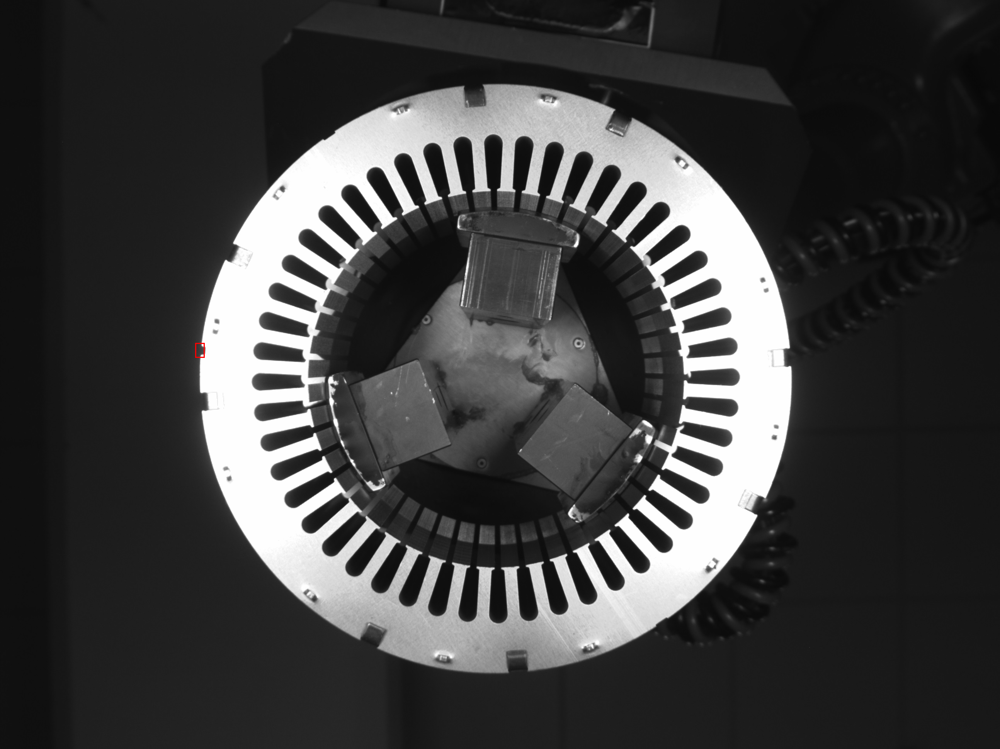

[  78.11445 1197.2968   112.62845 1239.8917 ]
(1197, 78) (1240, 113)


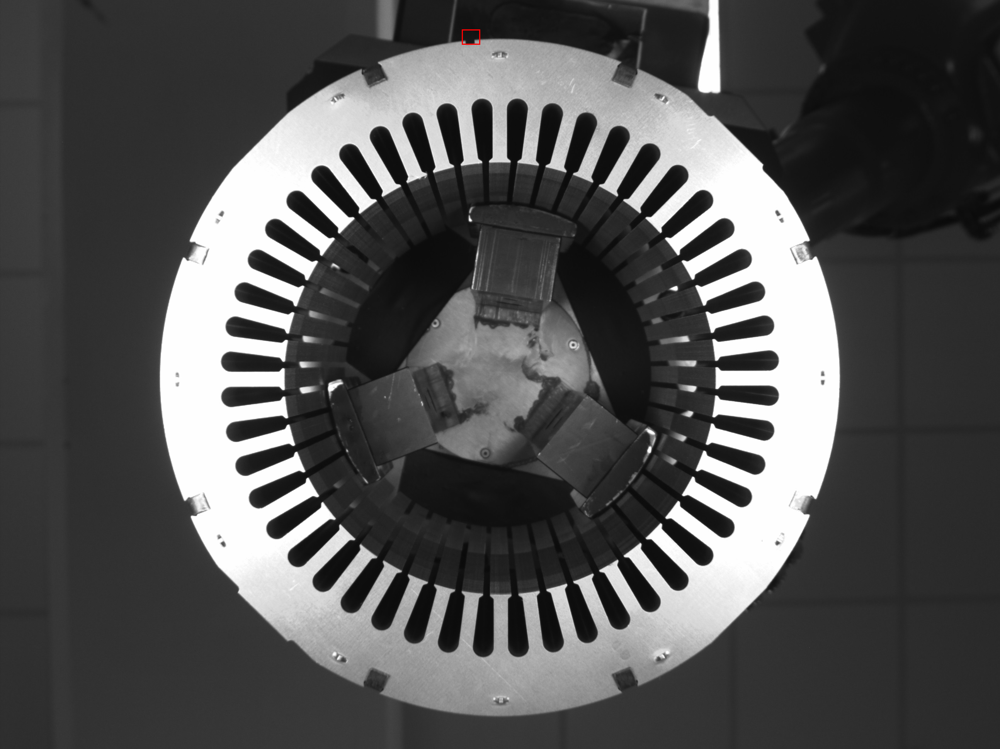

[791.31067 528.56036 825.25525 547.6393 ]
(529, 791) (548, 825)


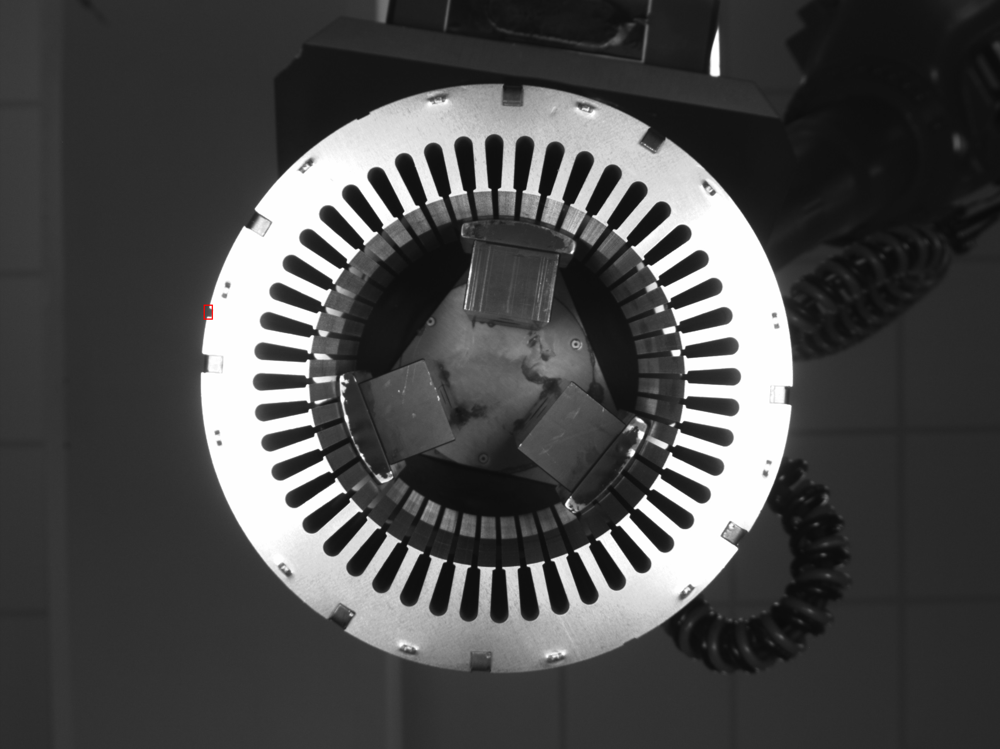

[701.6734  538.9111  736.58246 566.1647 ]
(539, 702) (566, 737)


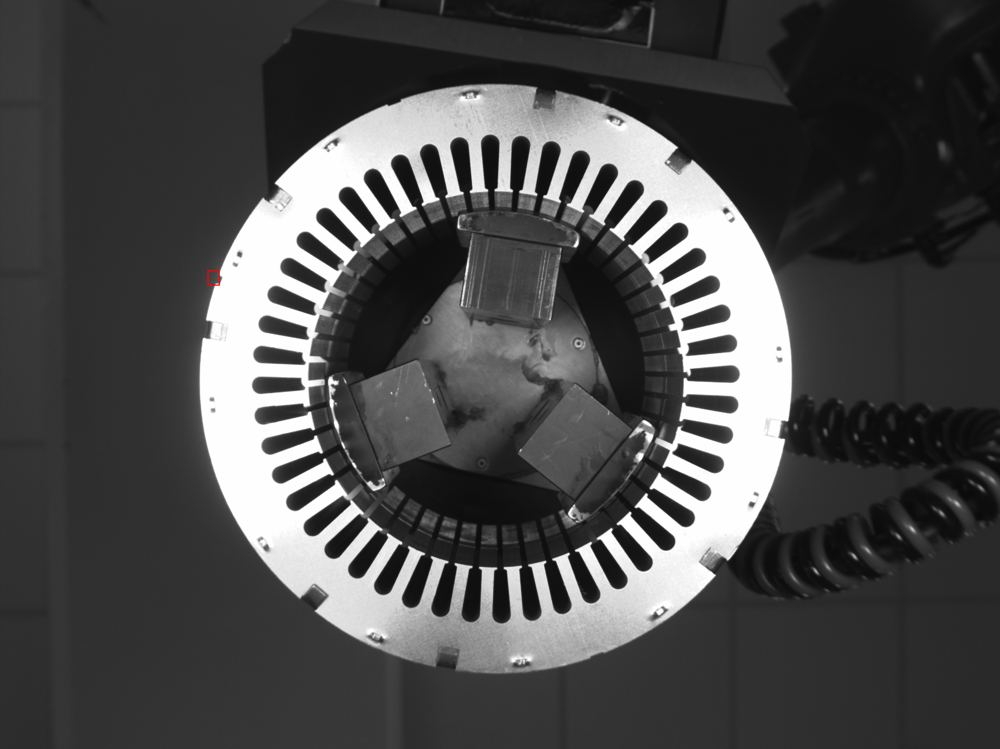

In [8]:
testimgpath = 'datasets/images/motorAnchorpoint/Img_testing'
imglist = os.listdir(testimgpath)
imglist = list(filter(lambda x: '.jpg' in x,imglist))

# %%time
for i in imglist:
    path = os.path.join(testimgpath,i)
    #path = 'Img/Testing/{}'.format(i)
    image = Image.open(path)
    boxes = yolo.detect_image(image)
    #display(drawimg(image.copy(),boxes[0]).resize((517,388)) )
    display(drawimg(image.copy(),boxes[0]))

if False:
    path = os.path.join(testimgpath,imglist[1])
    #path = 'Img/Testing/{}'.format(imglist[1])
    image = Image.open(path)
    boxes = yolo.detect_image(image)
    #display(drawimg(image.copy(),boxes[0]).resize((517,388)) )
    display(drawimg(image.copy(),boxes[0]))
    display(drawimg(image.copy(),boxes[1]))
    display(drawimg(image.copy(),boxes[2]))
    display(drawimg(image.copy(),boxes[3]))
    display(drawimg(image.copy(),boxes[4]))
    display(drawimg(image.copy(),boxes[5]))


